In [ ]:
import tensorflow as tf
import tensorflow.keras.layers as layers
import numpy as np
import IPython.display as display
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_hub as hub
import os
import datetime

%load_ext tensorboard

AUTOTUNE = tf.data.experimental.AUTOTUNE

In [ ]:
!rm -rf ./logs/

In [ ]:
data_dir = "dataset"
model_save_location = "models.h5"

# Load Data

In [ ]:
import pathlib

data_path = pathlib.Path(data_dir)
data_count = len(list(data_path.glob("*/*.jpg")))
data_count

353

In [ ]:
CLASS_NAMES = np.array([item.name for item in data_path.glob('*')])
CLASS_NAMES

array(['GMB 1', 'GMB 10', 'GMB 11', 'GMB 2', 'GMB 3', 'GMB 4', 'GMB 6',
       'GMB 7', 'GMB 8', 'GMB 9', 'GMB 5'], dtype='<U6')

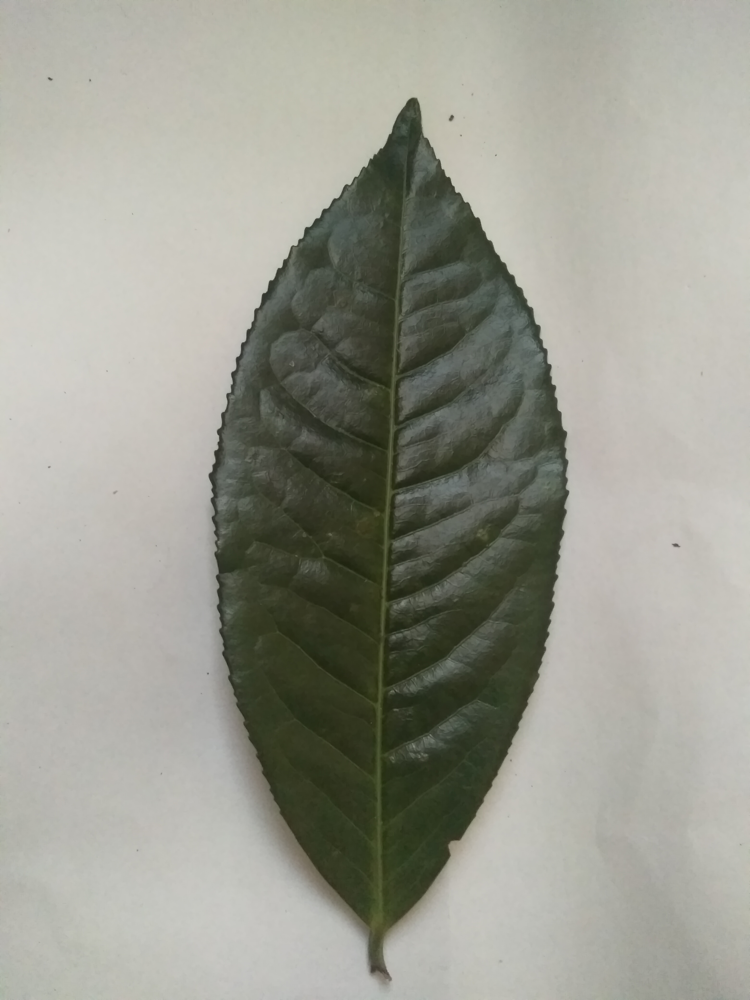

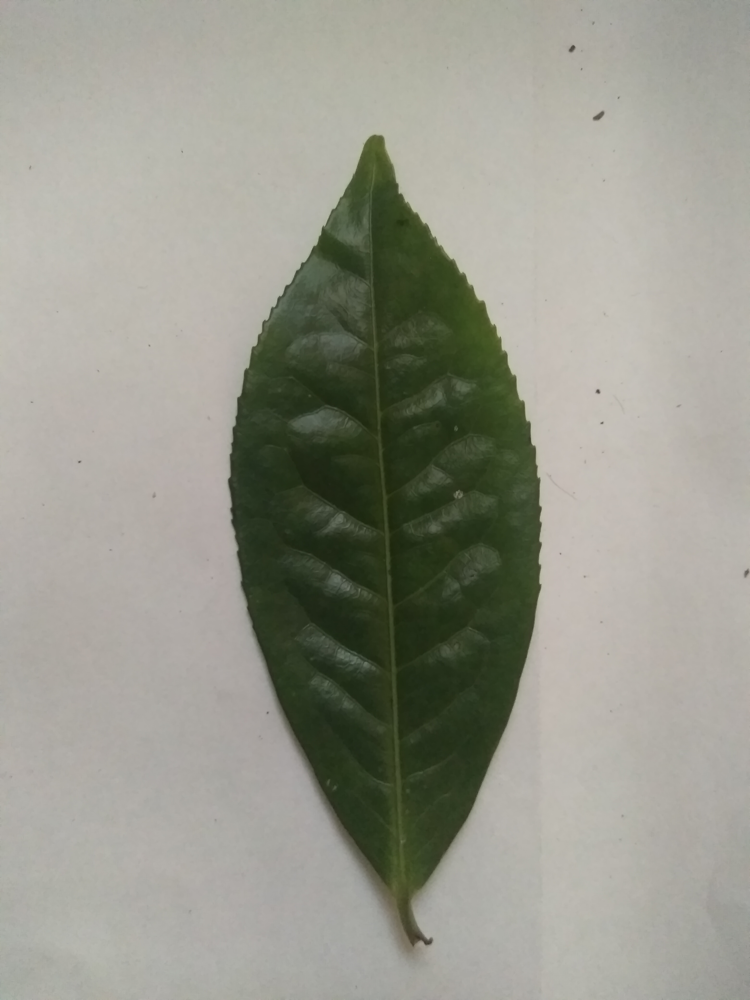

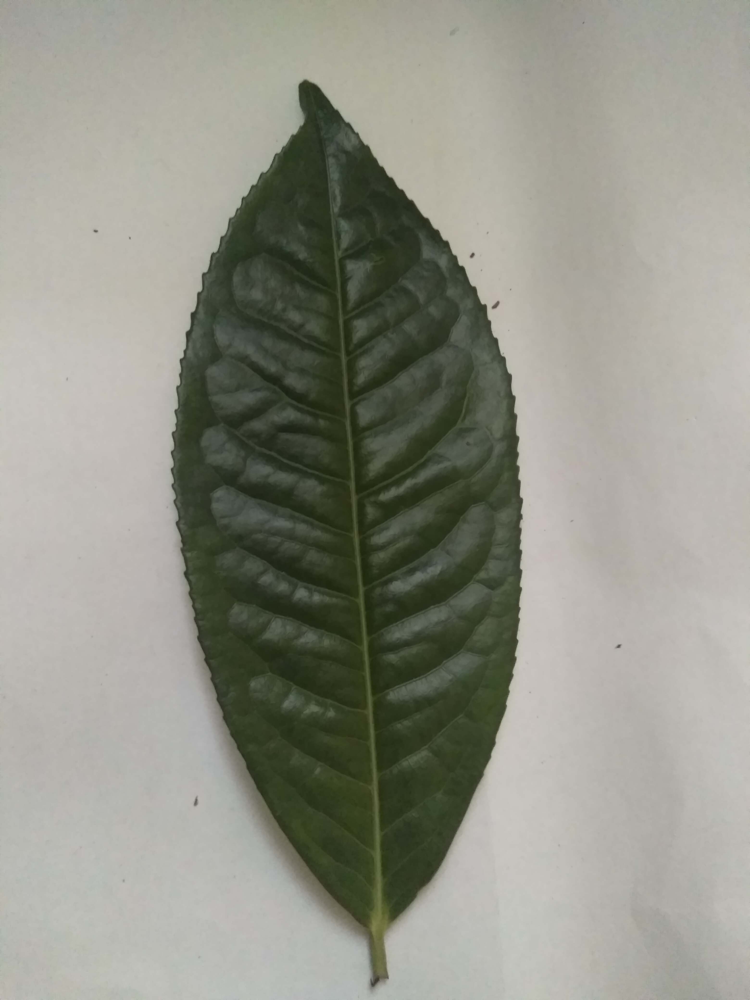

In [ ]:
daun = list(data_path.glob('GMB 1/*'))

for image_path in daun[:3]:
    display.display(Image.open(str(image_path)))

In [ ]:
BATCH_SIZE = 8
IMG_HEIGHT = 224
IMG_WIDTH = 224

In [ ]:
def show_batch(image_batch, label_batch):
    plt.figure(figsize=(10,10))
    for n in range(BATCH_SIZE):
        ax = plt.subplot(5,5,n+1)
        plt.imshow(image_batch[n])
        plt.title(CLASS_NAMES[label_batch[n]==1][0].title())
        plt.axis('off')

# Keras Preprocessing

In [ ]:
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255, 
    validation_split=0.3
)

In [ ]:
train_data = image_generator.flow_from_directory(directory=str(data_path),
                                                 batch_size=BATCH_SIZE,
                                                 shuffle=True,
                                                 target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                 classes = list(CLASS_NAMES),
                                                 subset='training')

Found 312 images belonging to 11 classes.


In [ ]:
validation_data = image_generator.flow_from_directory(directory=str(data_path),
                                                 batch_size=1,
                                                 shuffle=True,
                                                 target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                 classes = list(CLASS_NAMES),
                                                 subset='validation')

Found 133 images belonging to 11 classes.


In [ ]:
image_batch, label_batch = next(train_data)
label_batch
# show_batch(image_batch, label_batch)

array([[0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.],
       [0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.]], dtype=float32)

In [ ]:
def decode_img(img):
    # convert the compressed string to a 3D uint8 tensor
    img = tf.image.decode_jpeg(img, channels=3)
    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    img = tf.image.convert_image_dtype(img, tf.float32)
    # resize the image to the desired size.
    return tf.image.resize(img, [IMG_WIDTH, IMG_HEIGHT])

# Checkpoint

In [ ]:
# checkpoint_path = "checkpoint/cp-{epoch:04d}.ckpt"
checkpoint_path = "checkpoint/weight.h5"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 save_best_only=True,
                                                 verbose=1)
log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks = [
    cp_callback,
    tensorboard_callback,
    tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)
]


# Transfer Learrning TF-HUB

In [ ]:
IMAGE_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

In [ ]:
#feature_extractor_url = "https://tfhub.dev/google/imagenet/resnet_v1_152/feature_vector/4"
# feature_extractor_url = "https://tfhub.dev/google/imagenet/mobilenet_v2_050_96/feature_vector/4"
feature_extractor_url = "https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/feature_vector/4"
feature_extractor_layer = hub.KerasLayer(feature_extractor_url, input_shape=IMAGE_SHAPE,
                                        trainable=False)

model = tf.keras.Sequential([
    feature_extractor_layer,
    layers.Dense(11, activation='softmax')
])

# model.load_weights("checkpoint/transfer.h5")
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1792)              4363712   
_________________________________________________________________
dense (Dense)                (None, 11)                19723     
Total params: 4,383,435
Trainable params: 19,723
Non-trainable params: 4,363,712
_________________________________________________________________


In [ ]:
model.compile(
  optimizer=tf.keras.optimizers.Adam(),
  loss='categorical_crossentropy',
  metrics=['acc'])

In [ ]:
history = model.fit_generator(train_data, epochs=10,
                              steps_per_epoch=(312//8),
                              validation_data=validation_data,
                              validation_steps=133,
                              callbacks=callbacks
                             )

Epoch 1/10
38/39 [============================>.] - ETA: 1s - loss: 2.0010 - acc: 0.3355
Epoch 00001: val_loss improved from inf to 1.32216, saving model to checkpoint/weight.h5
39/39 [==============================] - 95s 2s/step - loss: 1.9732 - acc: 0.3462 - val_loss: 1.3222 - val_acc: 0.6541
Epoch 2/10
38/39 [============================>.] - ETA: 1s - loss: 0.8453 - acc: 0.7632
Epoch 00002: val_loss improved from 1.32216 to 1.02989, saving model to checkpoint/weight.h5
39/39 [==============================] - 74s 2s/step - loss: 0.8409 - acc: 0.7660 - val_loss: 1.0299 - val_acc: 0.6316
Epoch 3/10
38/39 [============================>.] - ETA: 1s - loss: 0.5442 - acc: 0.8849
Epoch 00003: val_loss improved from 1.02989 to 0.92227, saving model to checkpoint/weight.h5
39/39 [==============================] - 74s 2s/step - loss: 0.5521 - acc: 0.8782 - val_loss: 0.9223 - val_acc: 0.6692
Epoch 4/10
38/39 [============================>.] - ETA: 1s - loss: 0.4092 - acc: 0.9079
Epoch 00004:

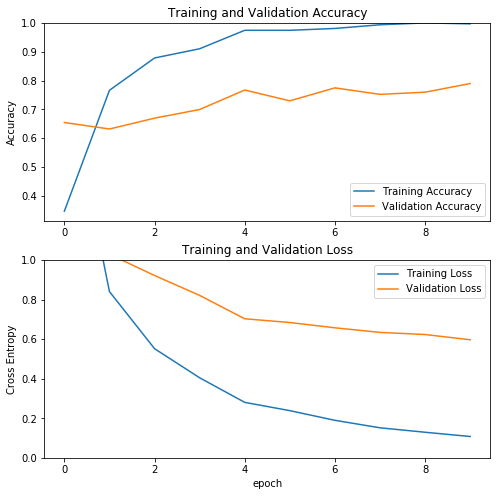

In [ ]:
acc = history.history['acc']
val_acc = history.history['val_acc']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# Evaluation

In [ ]:
# model.load_weights("checkpoint/weight_75.h5")
model.load_weights("checkpoint/weight.h5")
loss, acc = model.evaluate_generator(validation_data, steps=113)
print("Loss: ", loss)
print("Accuracy: ", acc)

Loss:  0.6275522199096735
Accuracy:  0.7876106


In [ ]:
validation_data.reset()

In [ ]:
CLASS_MAX_INDEX = 10
fail = []
for i in range(133):
    image, label = next(validation_data)
    y = model.predict(image)
    preds = np.argmax(y, axis=-1)
    label = np.argmax(label, axis=-1)
    
    if preds != label:
        fail.append([image, preds, label])

len(fail)

28

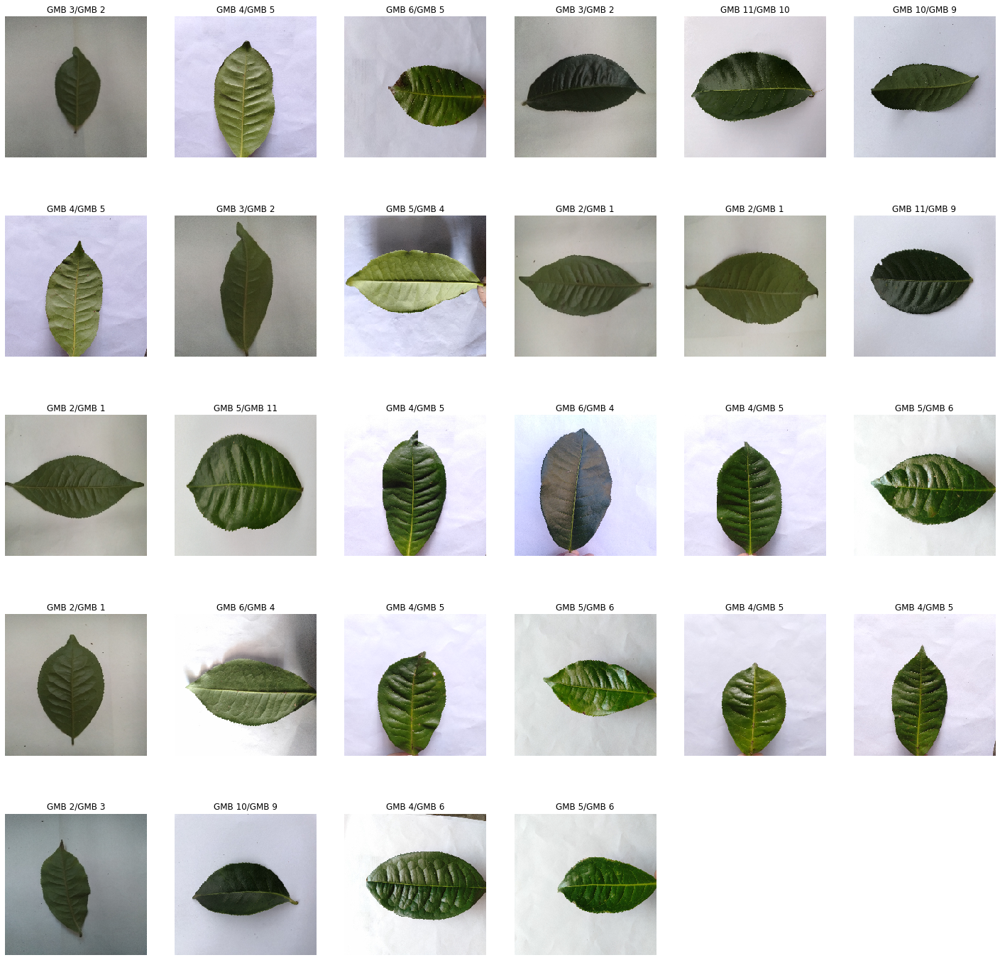

In [ ]:
plt.figure(figsize=(25,25))
for n in range(len(fail)):
    ax = plt.subplot(5,6,n+1)
    img = tf.squeeze(fail[n][0], axis=0)
    plt.imshow(img)
    pred = CLASS_NAMES[fail[n][1][0]]
    truth = CLASS_NAMES[fail[n][2][0]]
    plt.title(pred + "/" + truth)
    plt.axis('off')

In [ ]:
CLASS_MAX_INDEX = 10
success = []
for i in range(133):
    image, label = next(validation_data)
    y = model.predict(image)
    preds = np.argmax(y, axis=-1)
    label = np.argmax(label, axis=-1)
    
    if preds == label:
        success.append([image, preds, label])

len(success)

105

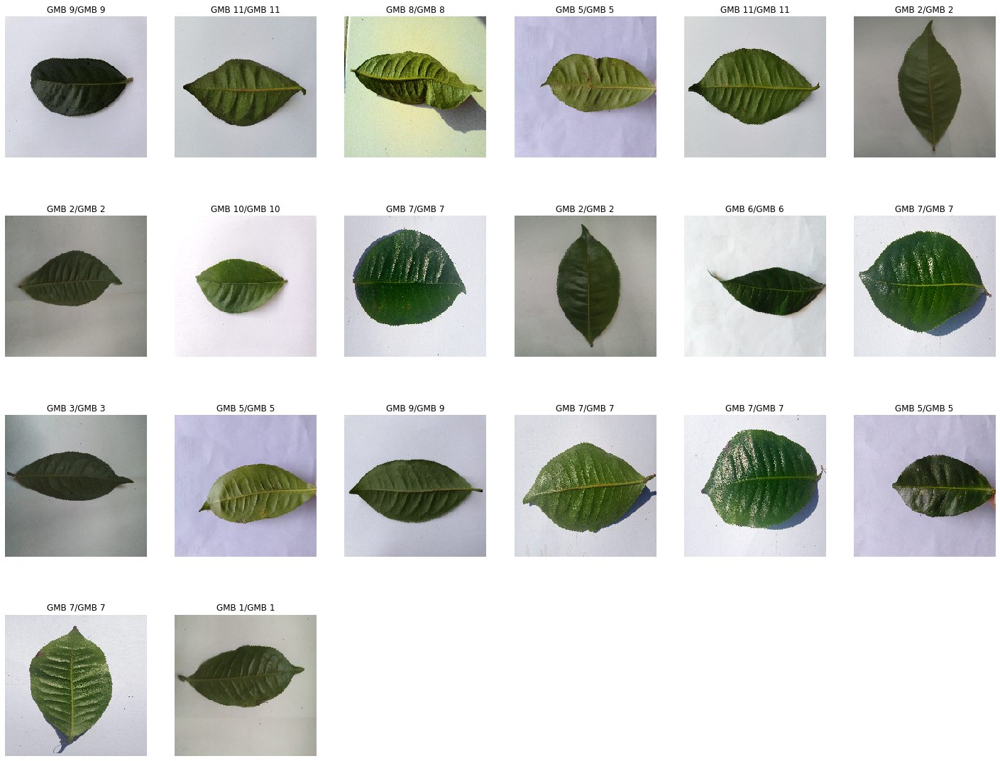

In [ ]:
plt.figure(figsize=(25,25))
for n in range(20):
    ax = plt.subplot(5,6,n+1)
    img = tf.squeeze(success[n][0], axis=0)
    plt.imshow(img)
    pred = CLASS_NAMES[success[n][1][0]]
    truth = CLASS_NAMES[success[n][2][0]]
    plt.title(pred + "/" + truth)
    plt.axis('off')

In [ ]:
# MAP
import pandas as pd
validation_data.reset()
CLASS_MAX_INDEX = 10
pred_list = []
for i in range(133):
    image, label = next(validation_data)
    pred = model.predict(image)[0]
    predSort = np.argsort(pred)
    top1, top2, top3 = predSort[CLASS_MAX_INDEX], predSort[CLASS_MAX_INDEX - 1], predSort[CLASS_MAX_INDEX - 2]
    top1, top2, top3 = CLASS_NAMES[top1].split()[1], CLASS_NAMES[top2].split()[1], CLASS_NAMES[top3].split()[1]
    m = np.argmax(pred)
    l = np.argmax(label[0])
    label_str = CLASS_NAMES[l].split()[1]
    pred_list.append([top1, top2, top3, label_str])

df = pd.DataFrame(pred_list, columns =['Top1', 'Top2', 'Top3', 'Label'])
df.to_csv('valres.csv')

# Test Data

In [ ]:
%tensorboard --logdir logs/fit

In [ ]:
import pathlib

test_path = pathlib.Path("ujidata/")
test_count = len(list(test_path.glob("*")))
test_count

55

In [ ]:
test_ds = tf.data.Dataset.list_files(str('ujidata/*'))

In [ ]:
def get_name(file_path):
    # convert the path to a list of path components
    parts = tf.strings.split(file_path, '/')
    p = tf.strings.split(parts[-1], ".")
    # The second to last is the class-directory
    return p[0]

In [ ]:
def process_test(file_path):
    label = get_name(file_path)
    # load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = decode_img(img)
    return img, label

In [ ]:
processed_test = test_ds.map(process_test, num_parallel_calls=AUTOTUNE)

In [ ]:
import pandas as pd

pred_list = []
CLASS_MAX_INDEX = 10
for test in processed_test:
    image, label = test
    image = tf.expand_dims(image, axis=0)
    pred = model.predict(image)[0]
    predSort = np.argsort(pred)
    top1, top2, top3 = predSort[CLASS_MAX_INDEX], predSort[CLASS_MAX_INDEX - 1], predSort[CLASS_MAX_INDEX - 2]
    top1, top2, top3 = CLASS_NAMES[top1].split()[1], CLASS_NAMES[top2].split()[1], CLASS_NAMES[top3].split()[1]
    m = np.argmax(pred)
    label_str = label.numpy().decode()
    pred_list.append([label_str, top1, top2, top3])

pred_list.sort(key=lambda x: int(x[0]))

df = pd.DataFrame(pred_list, columns =['Name', 'Top1', 'Top2', 'Top3'])
df.to_csv('result.csv')